#### Many Styles

In this notebook, we'll try 10 styles on a 2-D image, and try to create a video in the notebook of the 10 styles.  Later (but not in this notebook), we'll take these abilities and try to set our style loadings based on music.

In [1]:
import os
from infra.defs import STYLE_IMAGE_DIR

Let's load all the style images...

In [2]:
from image_processing import utils as img_utils

style_images = os.listdir(STYLE_IMAGE_DIR)
style_dict = {
    k.split('.')[0]:img_utils.load_img(os.path.join(STYLE_IMAGE_DIR, k), max_dim=256) for k in style_images
}

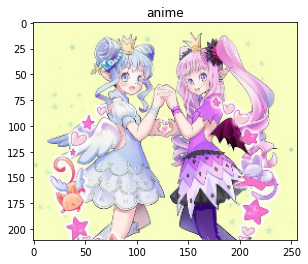

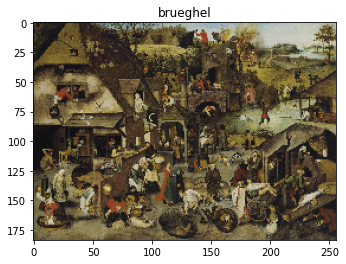

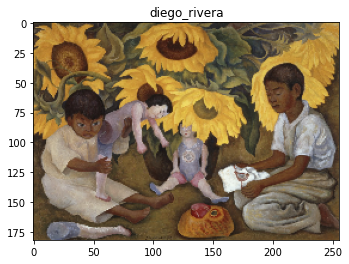

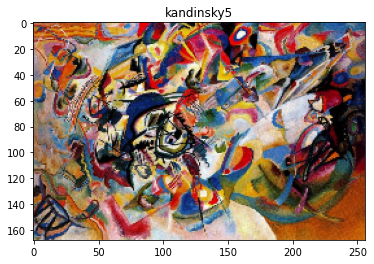

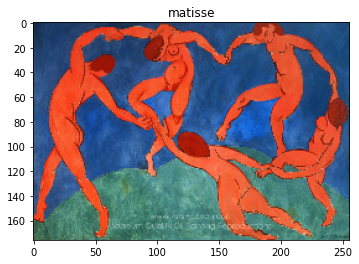

...

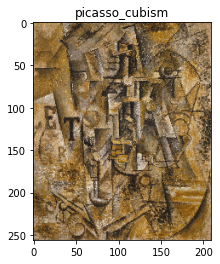

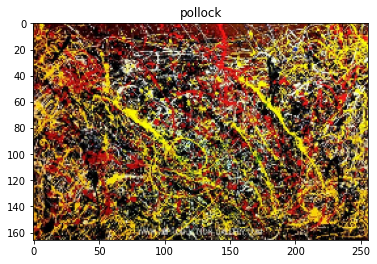

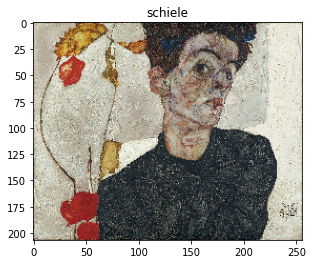

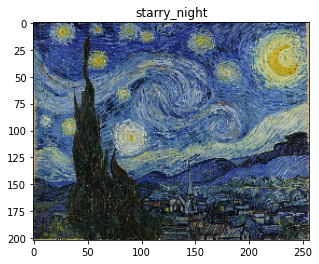

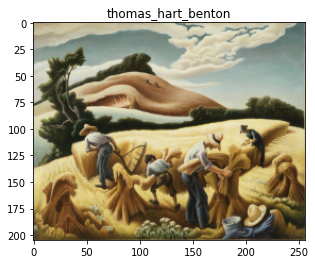

In [3]:
%matplotlib inline
from matplotlib import pyplot as plt

for k, v in style_dict.items():
    cur_img = img_utils.tensor_to_image(v)
    plt.figure()
    plt.imshow(cur_img)
    plt.title(k)

Now let's load our content image

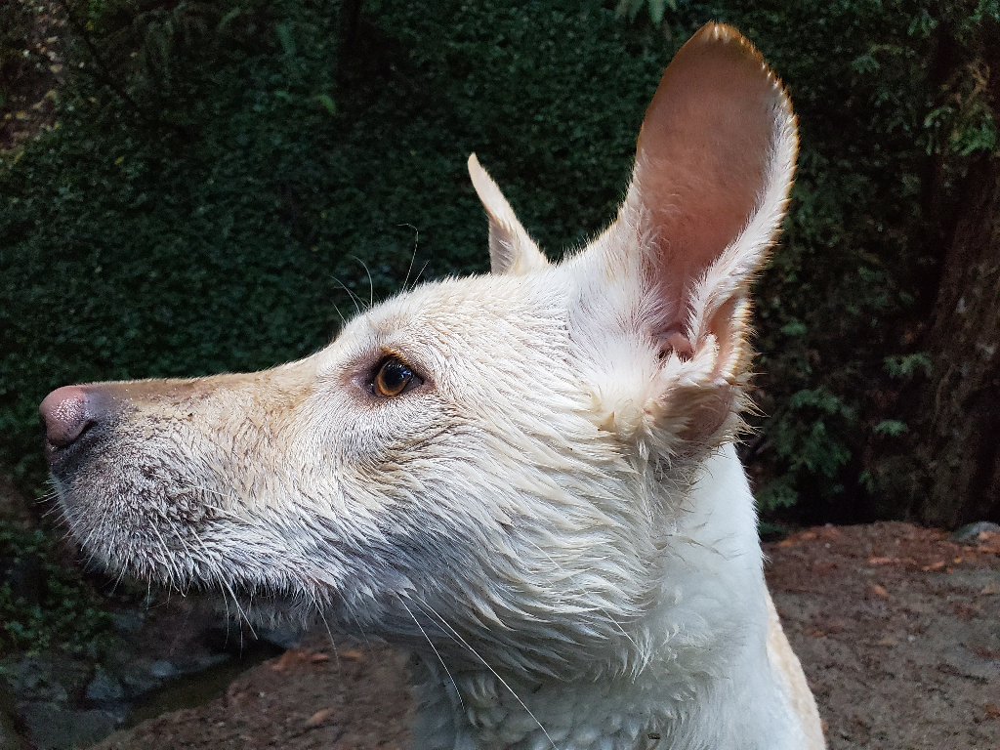

In [4]:
from infra.defs import CONTENT_IMAGE_DIR 

CONTENT_PATH = os.path.join(CONTENT_IMAGE_DIR, 'aloo.jpg')
CONTENT_IMAGE = img_utils.load_img(CONTENT_PATH, max_dim=1024)
img_utils.tensor_to_image(CONTENT_IMAGE)

In [5]:
from tqdm.notebook import tqdm
from image_processing.style_transfer import style_transfer

def get_transferred_image(style_image):
    return style_transfer(
        CONTENT_IMAGE,
        style_image,
    )

stylized_dict = {
    k: get_transferred_image(style_image) for k, style_image in tqdm(style_dict.items())
}

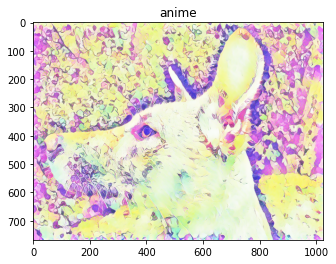

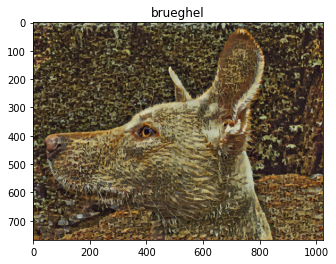

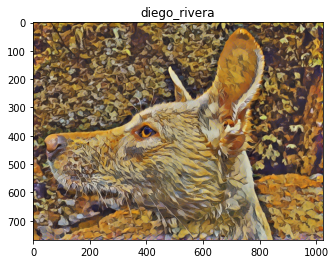

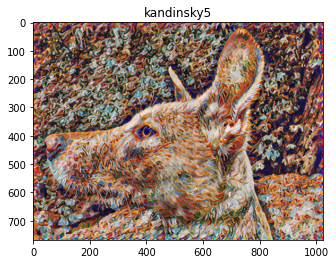

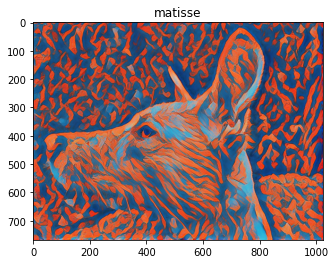

...

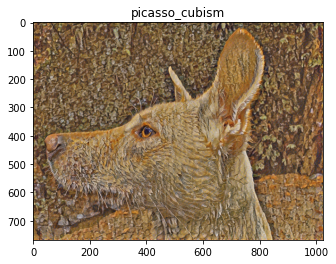

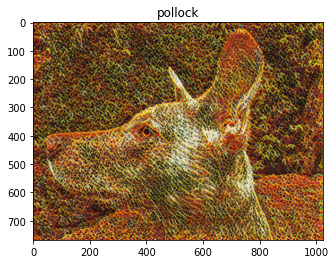

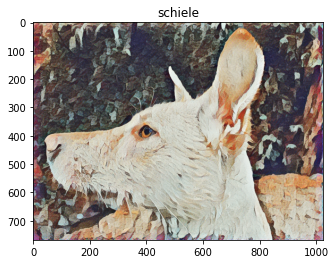

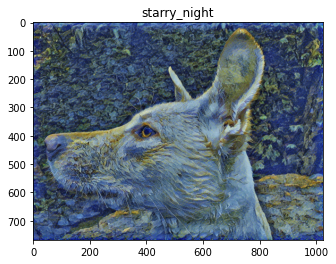

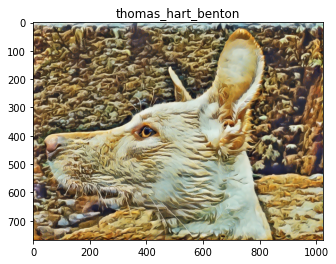

In [6]:
for k, v in stylized_dict.items():
    cur_img = img_utils.tensor_to_image(v)
    plt.figure()
    plt.imshow(cur_img)
    plt.title(k)

Let's try to create a transition video for these style transitions...

In [123]:
import numpy as np
from video_creation.interpolation_video_creator import InterpolationVideoCreator

aloo_images = list(stylized_dict.values())
ivc = InterpolationVideoCreator(aloo_images)

for idx in range(len(aloo_images) - 1):
    start_array = np.zeros(len(aloo_images))
    start_array[idx] = 1.
    end_array = np.zeros(len(aloo_images))
    end_array[idx + 1] = 1.
    ivc.add_linear_video_segment(
        start_array,
        end_array,
        n_seconds=0.5
    )
    
clip = ivc.stitch_video()
clip.ipython_display()

t:   5%|▍         | 8/165 [00:00<00:02, 78.44it/s, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


#### Dimension Reduction on the Images

Above, we were able to produce a video of Aloo going through different styles of painting.  However, some transitions were much starker than others!  Can we come up with some sort of low-dimensional embedding for the images such that we can determine their distances from each other?  This way,  

In [244]:
orig_images = [
    np.array(img_utils.tensor_to_image(x)) for x in aloo_images
]

In [311]:
image_matrix = np.array([x.flatten() for x in orig_images])

In [312]:
from sklearn.decomposition import PCA

pca = PCA()

In [313]:
pca.fit(image_matrix)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [324]:
img_components = [comp.reshape(aloo_images[0].shape)[0] for comp in pca.components_]

In [325]:
pca.explained_variance_ratio_

array([0.54918609, 0.16173677, 0.08884683, 0.07308669, 0.04792404,
       0.03032787, 0.02876863, 0.01098781, 0.00913526, 0.        ])

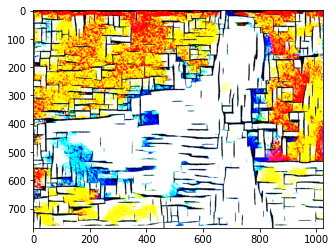

In [326]:
plt.imshow(10000 * img_components[0])

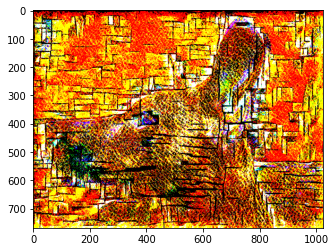

In [317]:
plt.imshow(img_components[1])

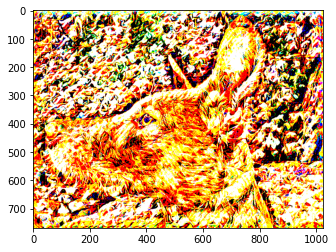

In [318]:
plt.imshow(img_components[2])

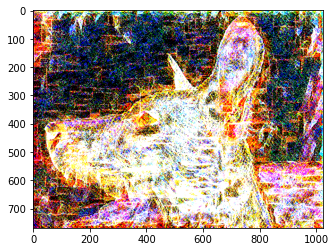

In [319]:
plt.imshow(img_components[3])

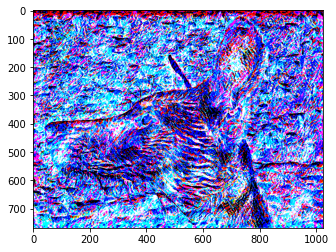

In [320]:
plt.imshow(img_components[4])

In [322]:
pca.transform(image_matrix)

array([[-48696.88449697,  11920.19730842, -13972.26535855,
        -13676.18465685, -16350.5701297 , -11426.36756165,
        -12740.34185093, -13148.81448984,  -5136.3787703 ,
            -0.        ],
       [-13915.35485513,   4013.29909511,  13844.36430564,
        -14144.85399474, -14770.44055137,   9505.87840616,
         -6116.17803733,  14120.49494556, -10371.89856695,
             0.        ],
       [-14275.41865914,  -1402.28819796,  39369.89148359,
        -15430.4985205 ,  31454.52342007,  -4830.24964588,
         -2601.25073205,  -3725.87251605,   -964.79840022,
            -0.        ],
       [136668.34457964,  32773.148674  , -12735.73983258,
         -7890.49543878,   3176.5234819 ,  -3904.50946566,
         -1030.50327057,   -210.28764009,   -406.01167423,
             0.        ],
       [ -1120.94185916, -27285.56135049, -21320.95968349,
         -3956.76623535,   8506.17671845,  22979.07225612,
         15146.04310592,  -6927.44384891,  -5149.60108814,
           

In [327]:
loadings = pca.transform(image_matrix)

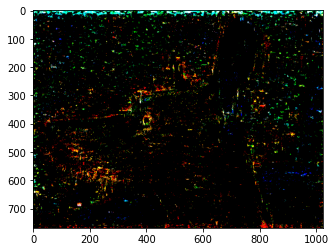

In [330]:
plt.imshow(np.tensordot(loadings[0, :], np.array(img_components), axes=1))

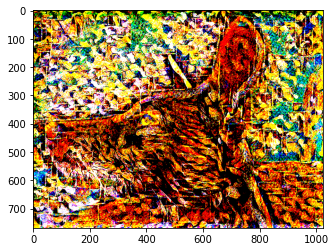

In [331]:
plt.imshow(np.tensordot(loadings[1, :], np.array(img_components), axes=1))

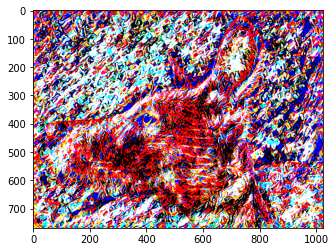

In [283]:
plt.imshow(np.tensordot(tx[2], np.array(img_components), axes=1))

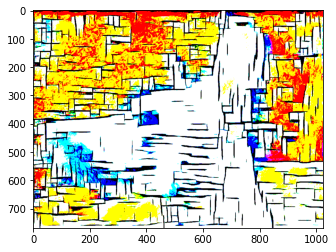

In [284]:
plt.imshow(np.tensordot(tx[3], np.array(img_components), axes=1))

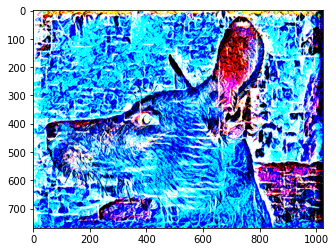

In [285]:
plt.imshow(np.tensordot(tx[4], np.array(img_components), axes=1))

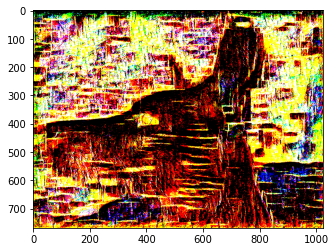

In [286]:
plt.imshow(np.tensordot(tx[5], np.array(img_components), axes=1))

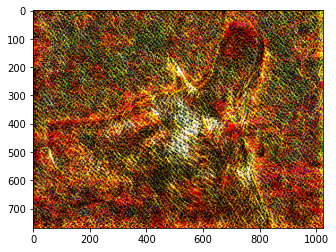

In [287]:
plt.imshow(np.tensordot(tx[6], np.array(img_components), axes=1))

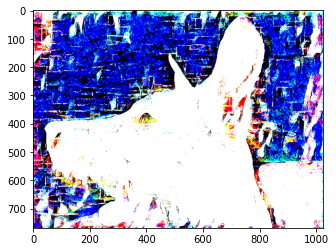

In [288]:
plt.imshow(np.tensordot(tx[7], np.array(img_components), axes=1))

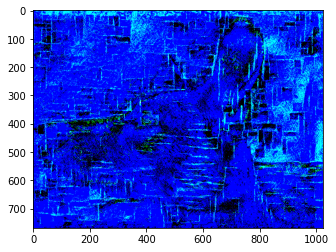

In [289]:
plt.imshow(np.tensordot(tx[8], np.array(img_components), axes=1))

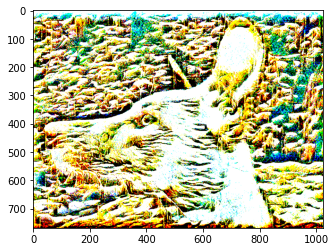

In [290]:
plt.imshow(np.tensordot(tx[9], np.array(img_components), axes=1))

In [231]:
q = np.array(orig_images).mean(axis=0)

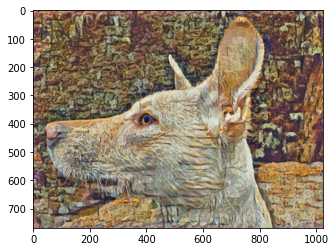

In [234]:
# What does the average picture look like
plt.imshow(q / (q.max() - q.min()))

In [218]:
pca.explained_variance_ratio_

array([5.49186095e-01, 1.61736772e-01, 8.88468325e-02, 7.30866880e-02,
       4.79240385e-02, 3.03278694e-02, 2.87686328e-02, 1.09878144e-02,
       9.13525822e-03, 9.99311868e-31])

In [215]:
np.array(img_components).sum(axis=0).shape

(768, 1024, 3)

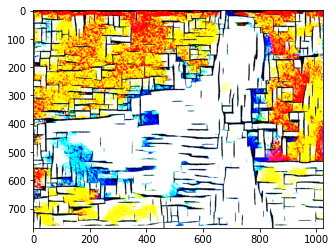

In [182]:
plt.imshow(zubba[0] * 10000)